In [1]:
import os
from IPython.display import Audio
import dotenv
import torch
from torchaudio import load
from matplotlib import pyplot as plt
import numpy as np
import librosa 

from hydra.utils import instantiate
from hydra import compose, initialize
import pytorch_lightning as pl
from omegaconf import DictConfig, open_dict
from audio_encoders_pytorch import ME1d, TanhBottleneck, STFT

os.chdir("train")
initialize(version_base=None, config_path="train", job_name="test_app")

hydra.initialize()

In [2]:
# cfg = compose(config_name="config")
cfg = compose(config_name="exp/dmae", 
               overrides=["+meta_dir=/data/meta", 
                          "+seed=12345",
                          # Options for less memory usage
                          "num_workers=2", 
                          "prefetch_factor=2",
                         ])

In [3]:
audio_data = instantiate(cfg.datamodule)
xeno_canto = instantiate(cfg.datamodule.datasets[0])

In [3]:
model = instantiate(cfg.model)

- The DMAE class holds a DiffusionAE instance called DMAE.model
- The DMAE.ema holds a reference to DMAE.model called ema.online_model
- The DMAE.ema also holds a seperate ema_model which is, during training, a smoothed version of the model in training. The model in training is of course DMAE.model aka. DMAE.ema.online_model 

In [4]:
print(type(model))
print(type(model.model))
print(type(model.ema.ema_model))
print(type(model.ema.online_model))
print(model.model is model.ema.online_model)
print(model.ema.ema_model is model.ema.online_model)

<class 'main.models.DMAE'>
<class 'audio_diffusion_pytorch.models.DiffusionAE'>
<class 'audio_diffusion_pytorch.models.DiffusionAE'>
<class 'audio_diffusion_pytorch.models.DiffusionAE'>
True
False


## Load diffae from training checkpoint

In [6]:
ckpt_dir = "/data/logs/ckpts/2024-01-11-15-18-08/epoch=57-valid_loss=0.036.ckpt"
ckpt = torch.load(ckpt_dir)

print(model.load_state_dict(ckpt["state_dict"]))
diffae = model.ema.ema_model

<All keys matched successfully>


## Load diffae from state_dict

In [5]:
from train.main.models import get_default_diffae
diffae_path = "/data/logs/ckpts/diffae_state_dict"
diffae = get_default_diffae(state_dict_file=diffae_path)
# torch.save(diffae.state_dict(), diffae_path)

## Test Diffae

In [9]:
device = 'cuda:0'
diffae.eval().to(device)
print(type(diffae))

<class 'audio_diffusion_pytorch.models.DiffusionAE'>


In [9]:
# on cropped samples that were not in the training dataset
test_batch = next(iter(audio_data.test_dataloader()))
sr = 32000
for i in range(5):
    wave = test_batch[i, ...].unsqueeze(0)
    
    #convert to batched stereo
    with torch.no_grad():
        latent = diffae.encode(wave.to(device))
        decoded = diffae.decode(latent, num_steps=100)
        
    print("wave shape:", wave.shape)
    print("latent shape:", latent.shape)
    display(Audio(data=wave.squeeze(0).cpu().numpy(), rate=sr))
    display(Audio(data=decoded.squeeze(0).cpu().numpy(), rate=sr))

wave shape: torch.Size([1, 2, 262144])
latent shape: torch.Size([1, 32, 256])


wave shape: torch.Size([1, 2, 262144])
latent shape: torch.Size([1, 32, 256])


wave shape: torch.Size([1, 2, 262144])
latent shape: torch.Size([1, 32, 256])


wave shape: torch.Size([1, 2, 262144])
latent shape: torch.Size([1, 32, 256])


wave shape: torch.Size([1, 2, 262144])
latent shape: torch.Size([1, 32, 256])


In [10]:
# on longer samples
for idx, file in enumerate(xeno_canto.files[:5]):
    wave, sr = load(file, num_frames=2**19)
    
    if wave.shape[1] < 2**19: 
        continue
        
    wave = torch.cat([wave, wave]).unsqueeze(0)
        
    #convert to batched stereo
    with torch.no_grad():
        latent = diffae.encode(wave.to(device))
        decoded = diffae.decode(latent, num_steps=100)
        
    if idx == 0:
        print("wave shape:", wave.shape)
        print("latent shape:", latent.shape)
        
    print(idx)
    display(Audio(data=wave.squeeze(0).cpu().numpy(), rate=sr))
    display(Audio(data=decoded.squeeze(0).cpu().numpy(), rate=sr))

wave shape: torch.Size([1, 2, 524288])
latent shape: torch.Size([1, 32, 512])
0


3


4


In [27]:
import librosa
import os
import matplotlib.pyplot as plt
import numpy as np
from random import shuffle

stft_config = dict(
    hop_length = 256,
    n_fft = 1024,
)

base_dir = "/data/tests/generated/diffae_baseline"
gen_dir = "/data/tests/generated/diffae_generated"

samples = os.listdir(base_dir)
shuffle(samples)

def plot_spec(file):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    for i, ax in enumerate(axes):
        if i == 0:
            title = "Original"
            dir = base_dir
            y, sr = librosa.load(os.path.join(dir, file))
            length = y.shape[-1]
        else:
            title = "DiffAE"
            dir = gen_dir
            y, sr = librosa.load(os.path.join(dir, file))
            y = y[:length]
        
        spec = librosa.stft(y, **stft_config)
        fft_in_db = librosa.amplitude_to_db(np.abs(spec), ref=np.min)
        img = librosa.display.specshow(fft_in_db,
                                        x_axis="time",
                                        y_axis="log",
                                        ax=ax,
                                        sr=sr,
                                        **stft_config,
                                        )
        ax.set_title(title)
        ax.set_xlabel("Time [s]")
        ax.set_ylabel("Frequency [Hz]")
        
    # fig.colorbar(img, ax=ax, format="%+2.f dB")
    return fig

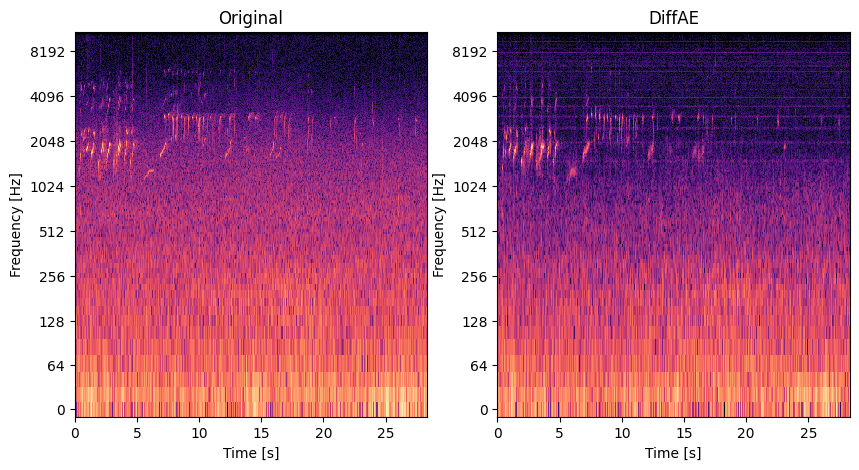

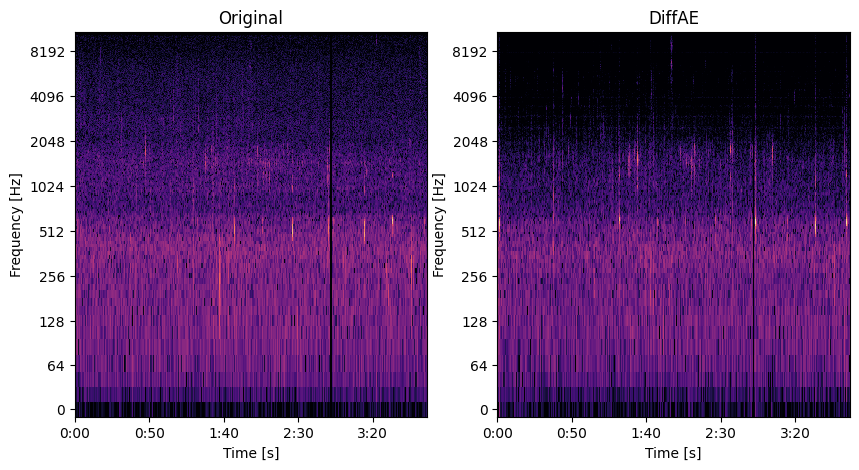

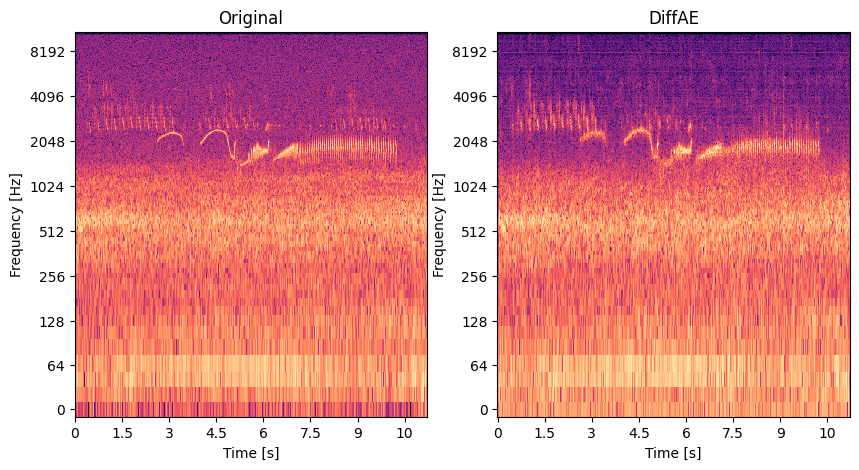

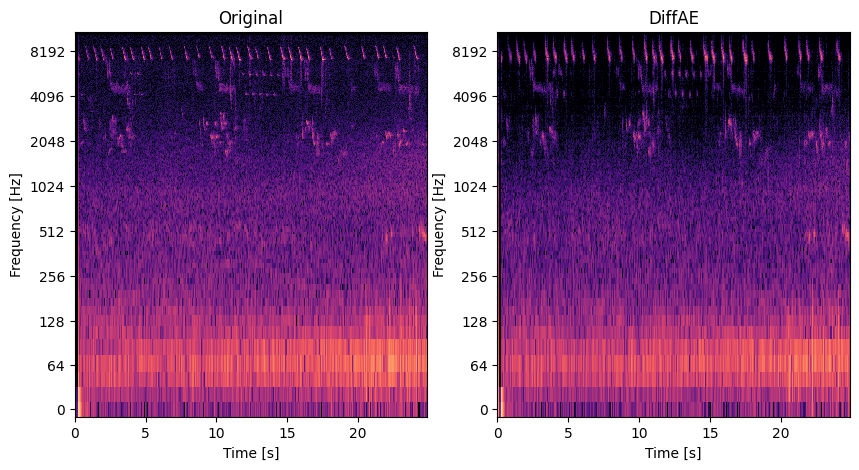

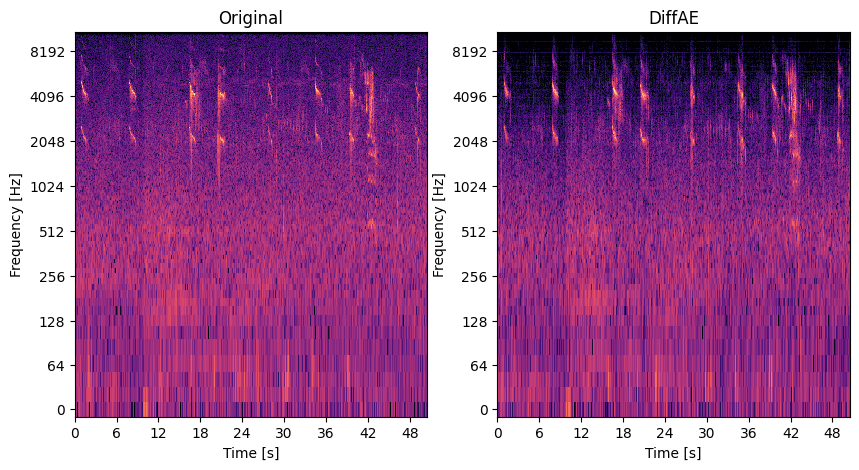

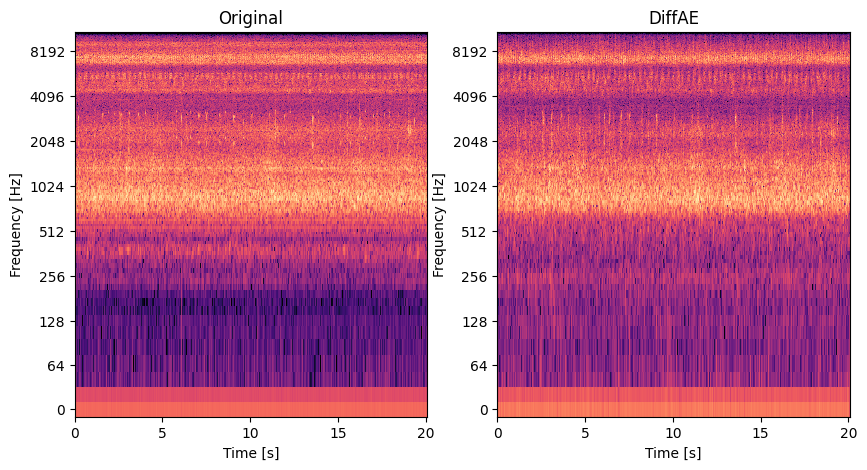

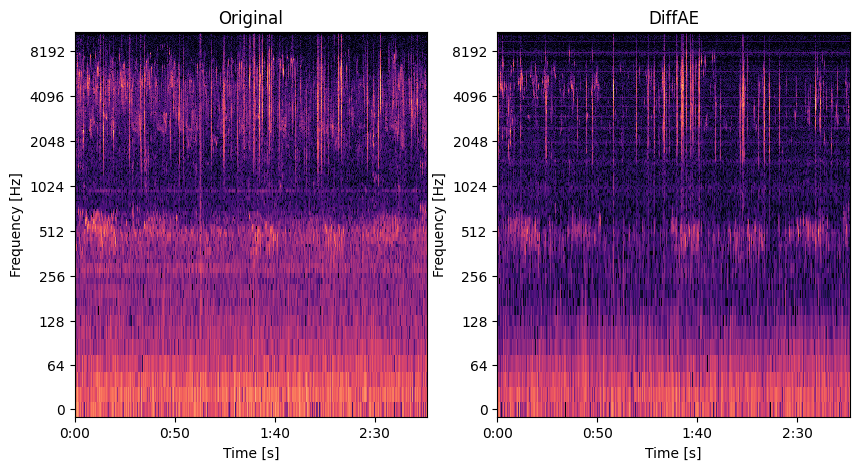

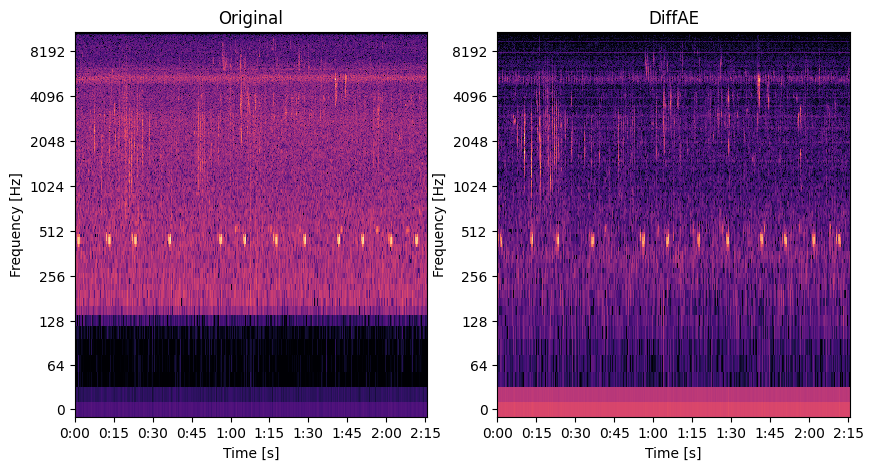

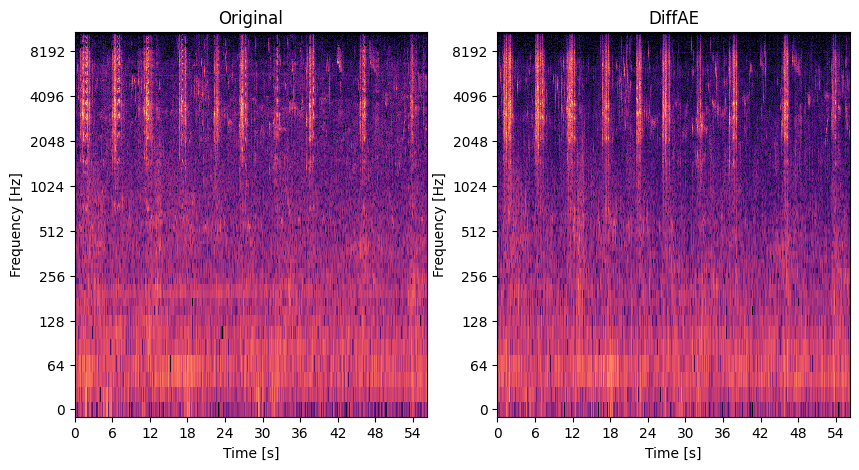

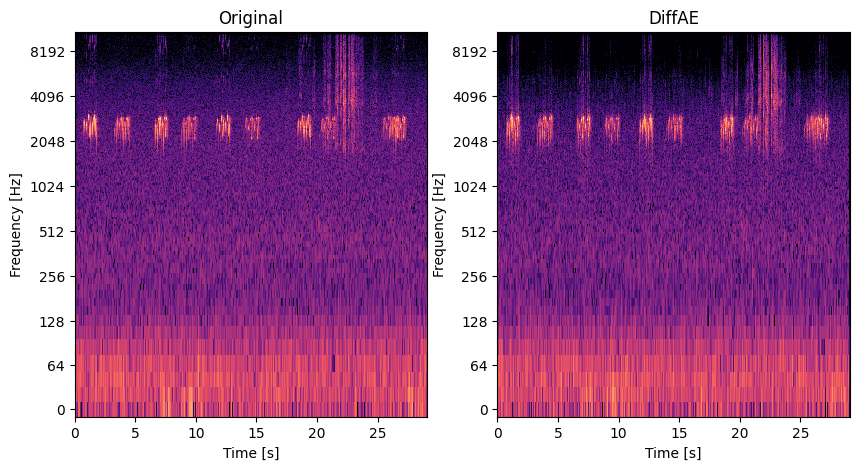

In [36]:
for sample in samples[:10]:
    fig = plot_spec(sample)    
    fig.savefig(f"/data/plots/diffae_spectrograms/{sample[:-4]}.png")
    plt.show()

In [4]:
# Warning: sr should be 32000 but is 48000
file = '../20230712_090000.WAV'

waveform, sr = liborsa.load(file, sr=32_000)
waveform = torch.tensor(waveform)
print(waveform.shape)
waveform = waveform[..., :2**18]
waveform = torch.cat([waveform, waveform]).unsqueeze(0).to(device)

with torch.no_grad():
    print('Original')
    display(Audio(data=waveform.squeeze(0).cpu().numpy(), rate=sr))
    latent = diffae.encode(waveform)

    for steps in [10, 100, 500, 1000]:
        print(f'with {steps} steps:')
        decoded = diffae.decode(latent, num_steps=steps)
        display(Audio(data=decoded.squeeze(0).cpu().numpy(), rate=sr))

NameError: name 'liborsa' is not defined

In [ ]:
# testing on very different audio
steps = 100
dir = "/data/feedback_fva"
# note all have the same sr=32000 but not all have same length

for i, file in zip(range(5), os.listdir(dir)):
    print(i)
    file = os.path.join(dir, file)
    waveform, sr = load(file)
    waveform = waveform[..., :2**18]
    waveform = torch.cat([waveform, waveform]).unsqueeze(0).to(device)

    with torch.no_grad():
        display(Audio(data=waveform.squeeze(0).cpu().numpy(), rate=sr))
        latent = diffae.encode(waveform)
        decoded = diffae.decode(latent, num_steps=steps)
        display(Audio(data=decoded.squeeze(0).cpu().numpy(), rate=sr))

### Testing Encoder Stage and Spectrogram

In [6]:
# the encoder stage of the autoencoder
full_mag_encoder = ME1d(
        in_channels=2,
        channels=512,
        multipliers=[1, 1, 1],
        factors=[2, 2],
        num_blocks=[4, 8],
        stft_num_fft=1023,
        stft_hop_length=256, 
        out_channels=32,
        bottleneck=TanhBottleneck()
        ) 

# A component of full_mag_encoder that generates a magnitude spectrogram
mag_stft = STFT(num_fft=1023, hop_length=256)

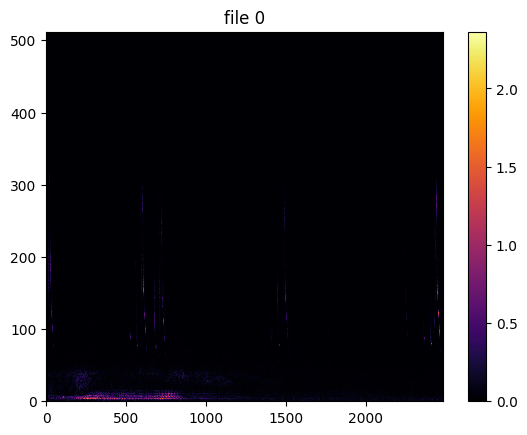

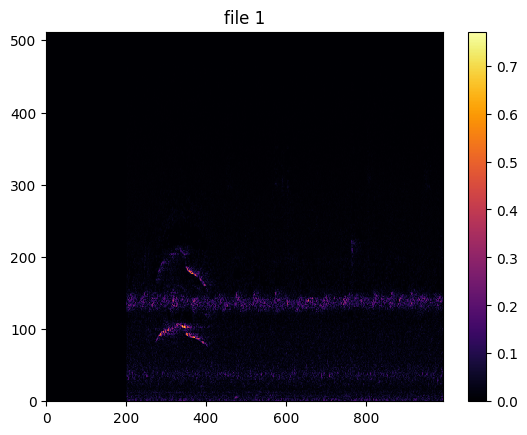

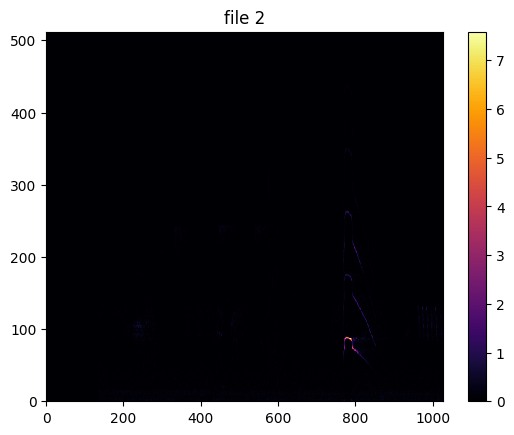

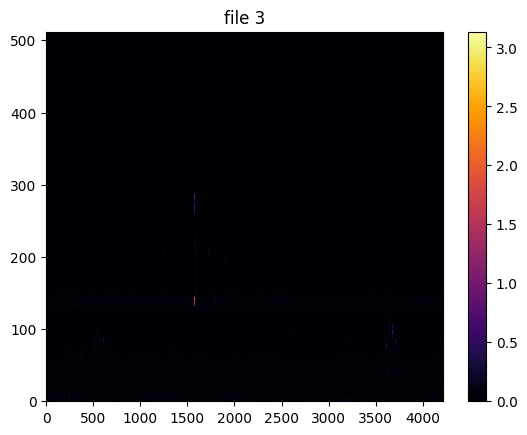

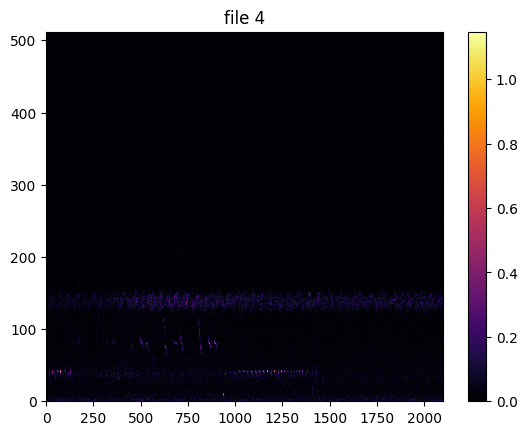

In [7]:
for idx, file in enumerate(xeno_canto.files[:5]):
    wave, sr = load(file)
    stereo_batched = torch.cat([wave, wave]).unsqueeze(0)
    
    encoded = mag_stft.encode(stereo_batched)
    mag, angle = tuple(encoded)
    mag_mono = mag.squeeze(0).mean(0)
    
    plt.pcolormesh(mag_mono, cmap="inferno")
    plt.title(f"file {idx}")
    plt.colorbar() 
    plt.show()

    display(Audio(file))